In [75]:
!pip install pyyaml==5.1
import torch, torchvision
print(torch.__version__, torch.cuda.is_available())
!gcc --version

1.7.0+cu101 True
gcc (Ubuntu 7.5.0-3ubuntu1~18.04) 7.5.0
Copyright (C) 2017 Free Software Foundation, Inc.
This is free software; see the source for copying conditions.  There is NO
warranty; not even for MERCHANTABILITY or FITNESS FOR A PARTICULAR PURPOSE.



In [76]:
import torch
assert torch.__version__.startswith("1.7")
!pip install detectron2 -f https://dl.fbaipublicfiles.com/detectron2/wheels/cu101/torch1.7/index.html

Looking in links: https://dl.fbaipublicfiles.com/detectron2/wheels/cu101/torch1.7/index.html


In [77]:
import detectron2
from detectron2.utils.logger import setup_logger
setup_logger()

# import some common libraries
import numpy as np
import os, json, cv2, random
from google.colab.patches import cv2_imshow

# import some common detectron2 utilities
from detectron2 import model_zoo
from detectron2.engine import DefaultPredictor
from detectron2.config import get_cfg
from detectron2.utils.visualizer import Visualizer
from detectron2.data import MetadataCatalog, DatasetCatalog

In [71]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [72]:
from detectron2.data.datasets import register_coco_instances
register_coco_instances("trainDS", {}, "/content/drive/MyDrive/COCO/train.json", "/content/drive/MyDrive/dataset1000/train")
register_coco_instances("valDS", {}, "/content/drive/MyDrive/COCO/val.json", "/content/drive/MyDrive/dataset1000/val")


AssertionError: ignored

In [78]:
metadata = MetadataCatalog.get("trainDS")

In [79]:
dataset_dicts = DatasetCatalog.get("trainDS")

[02/16 17:39:11 d2.data.datasets.coco]: Loaded 892 images in COCO format from /content/drive/MyDrive/COCO/train.json


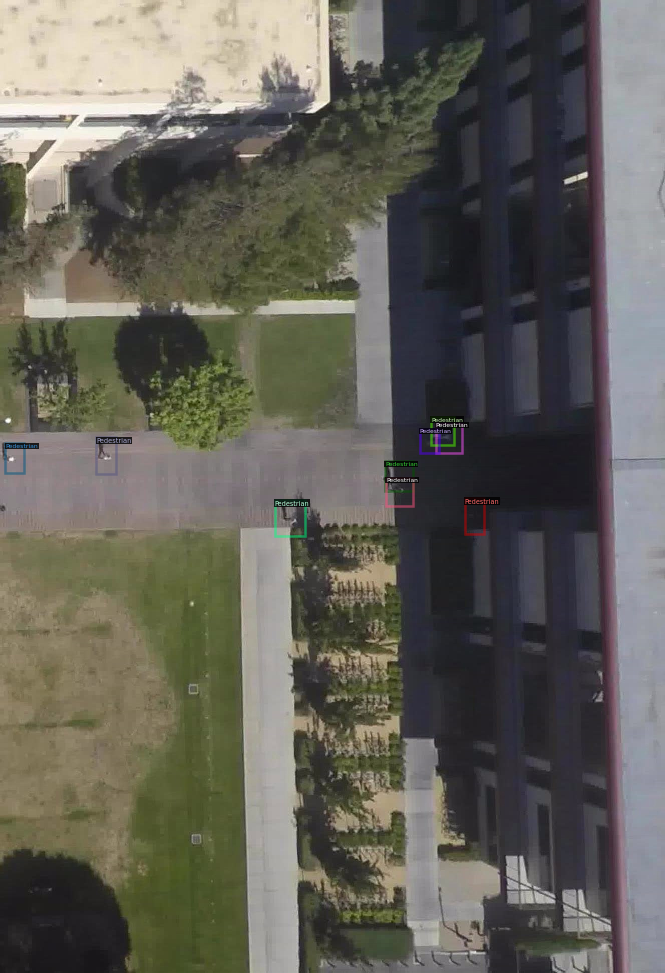

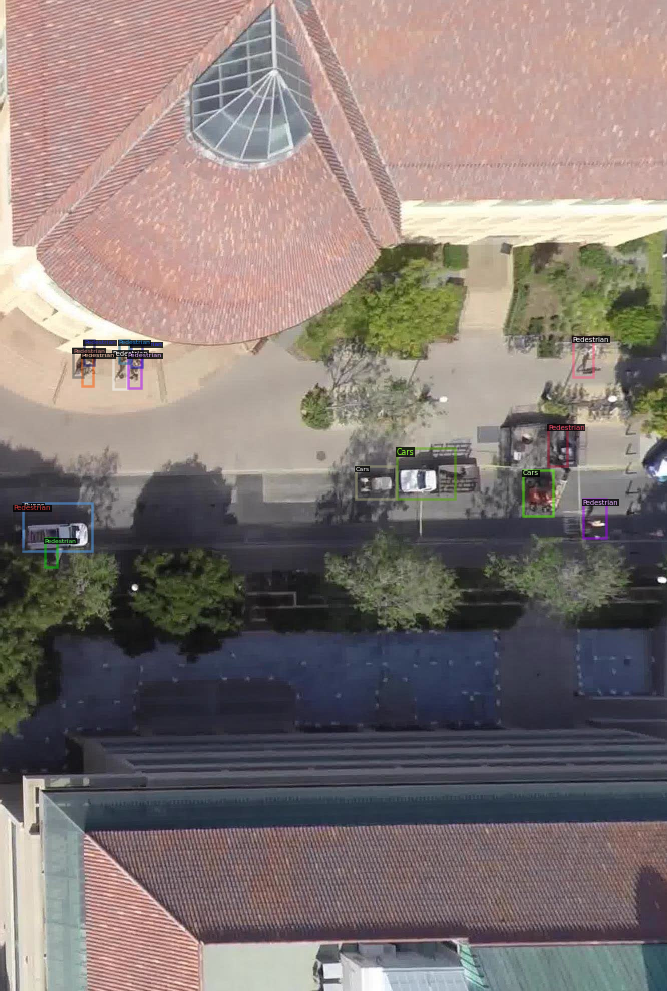

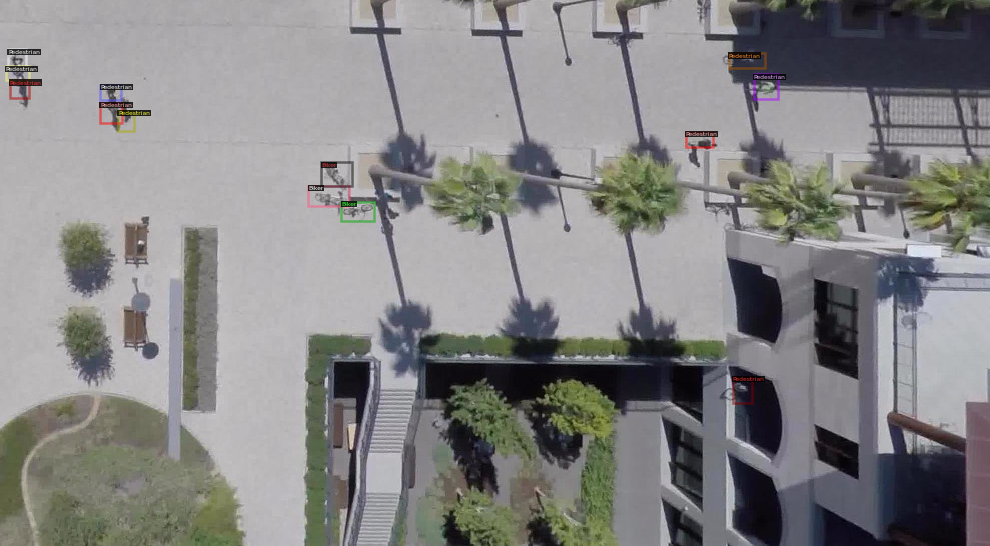

In [80]:
import random
from detectron2.utils.visualizer import Visualizer

for d in random.sample(dataset_dicts, 3):
    img = cv2.imread(d['file_name'])
    visualizer = Visualizer(img[:, :, ::-1], metadata=metadata, scale=0.5)
    vis = visualizer.draw_dataset_dict(d)
    cv2_imshow(vis.get_image()[:, :, ::-1])

In [81]:
from detectron2.engine import DefaultTrainer
from detectron2.config import get_cfg
import os

cfg = get_cfg()
cfg.merge_from_file(
    model_zoo.get_config_file("COCO-Detection/faster_rcnn_R_50_FPN_3x.yaml")
)
cfg.DATASETS.TRAIN = ("trainDS",)
cfg.DATASETS.TEST = ("valDS",)  # no metrics implemented for this dataset
cfg.DATALOADER.NUM_WORKERS = 2
cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-Detection/faster_rcnn_R_50_FPN_3x.yaml")  # initialize from model zoo
cfg.SOLVER.IMS_PER_BATCH = 2
cfg.SOLVER.BASE_LR = 0.02
cfg.SOLVER.MAX_ITER = (
    300
)  # 300 iterations seems good enough, but you can certainly train longer
cfg.MODEL.ROI_HEADS.BATCH_SIZE_PER_IMAGE = (
    128
)  # faster, and good enough for this toy dataset
cfg.MODEL.ROI_HEADS.NUM_CLASSES = 6  # 6 classes

os.makedirs(cfg.OUTPUT_DIR, exist_ok=True)
trainer = DefaultTrainer(cfg)
trainer.resume_or_load(resume=False)
trainer.train()

[02/16 17:39:21 d2.engine.defaults]: Model:
GeneralizedRCNN(
  (backbone): FPN(
    (fpn_lateral2): Conv2d(256, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelMaxPool()
    (bottom_up): ResNet(
      (stem): BasicStem(
        (conv1): Conv2d(
          3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
      )
      (res

Skip loading parameter 'roi_heads.box_predictor.cls_score.weight' to the model due to incompatible shapes: (81, 1024) in the checkpoint but (7, 1024) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.cls_score.bias' to the model due to incompatible shapes: (81,) in the checkpoint but (7,) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.bbox_pred.weight' to the model due to incompatible shapes: (320, 1024) in the checkpoint but (24, 1024) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.bbox_pred.bias' to the model due to incompatible shapes: (320,) in the checkpoint but (24,) in the model! You might want to double check if this is expected.


[02/16 17:39:22 d2.engine.train_loop]: Starting training from iteration 0
[02/16 17:39:31 d2.utils.events]:  eta: 0:02:00  iter: 19  total_loss: 2.455  loss_cls: 1.542  loss_box_reg: 0.4643  loss_rpn_cls: 0.3175  loss_rpn_loc: 0.2789  time: 0.4371  data_time: 0.0368  lr: 0.00039962  max_mem: 2706M
[02/16 17:39:40 d2.utils.events]:  eta: 0:01:53  iter: 39  total_loss: 1.983  loss_cls: 0.8709  loss_box_reg: 0.7877  loss_rpn_cls: 0.1798  loss_rpn_loc: 0.144  time: 0.4384  data_time: 0.0067  lr: 0.00079922  max_mem: 2706M
[02/16 17:39:48 d2.utils.events]:  eta: 0:01:43  iter: 59  total_loss: 1.997  loss_cls: 0.7879  loss_box_reg: 0.7956  loss_rpn_cls: 0.1751  loss_rpn_loc: 0.1915  time: 0.4339  data_time: 0.0078  lr: 0.0011988  max_mem: 2706M
[02/16 17:39:57 d2.utils.events]:  eta: 0:01:35  iter: 79  total_loss: 1.835  loss_cls: 0.703  loss_box_reg: 0.8278  loss_rpn_cls: 0.1394  loss_rpn_loc: 0.1393  time: 0.4335  data_time: 0.0064  lr: 0.0015984  max_mem: 2706M
[02/16 17:40:06 d2.utils.ev

In [82]:
%reload_ext tensorboard
%tensorboard --logdir output

Reusing TensorBoard on port 6006 (pid 665), started 0:51:57 ago. (Use '!kill 665' to kill it.)

<IPython.core.display.Javascript object>

In [83]:
cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.5   # set the testing threshold for this model
cfg.DATASETS.TEST = ("valDS", )
predictor = DefaultPredictor(cfg)

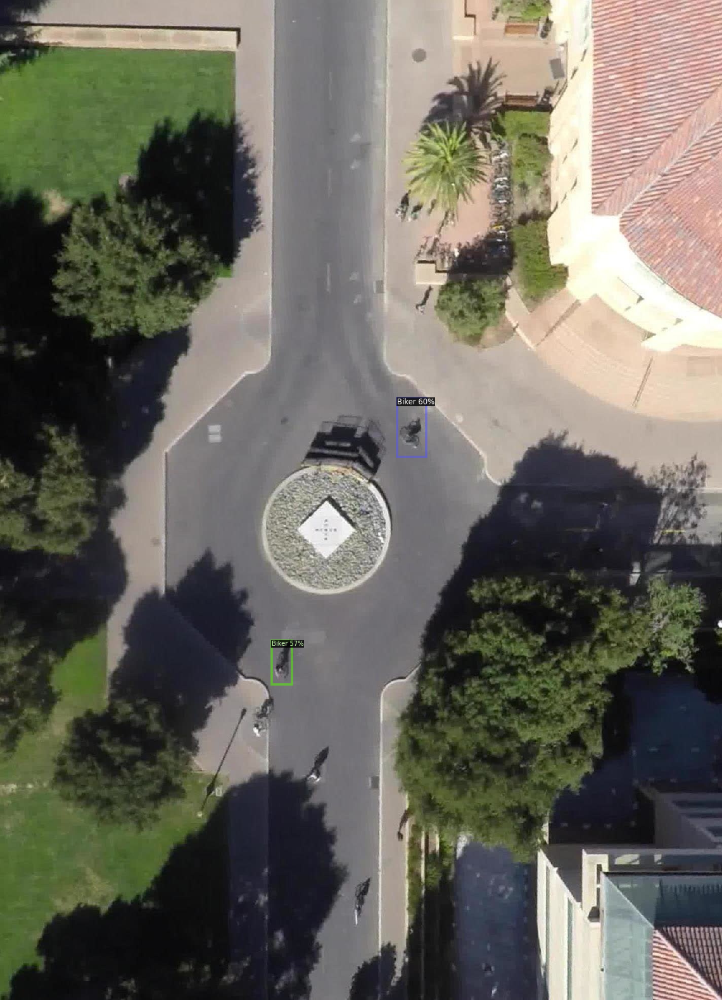

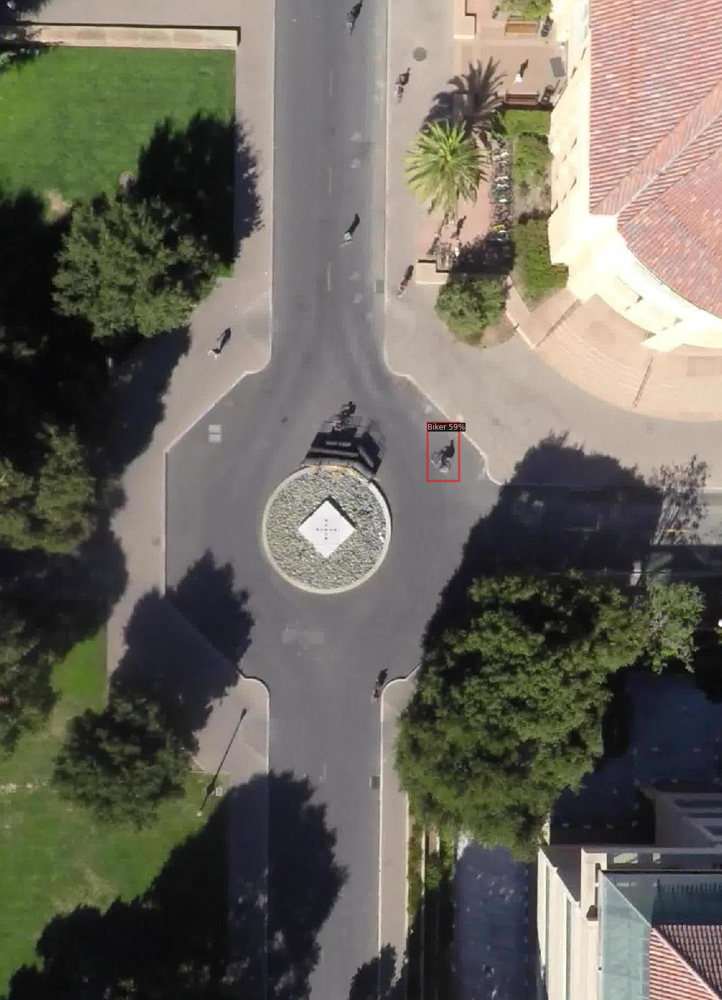

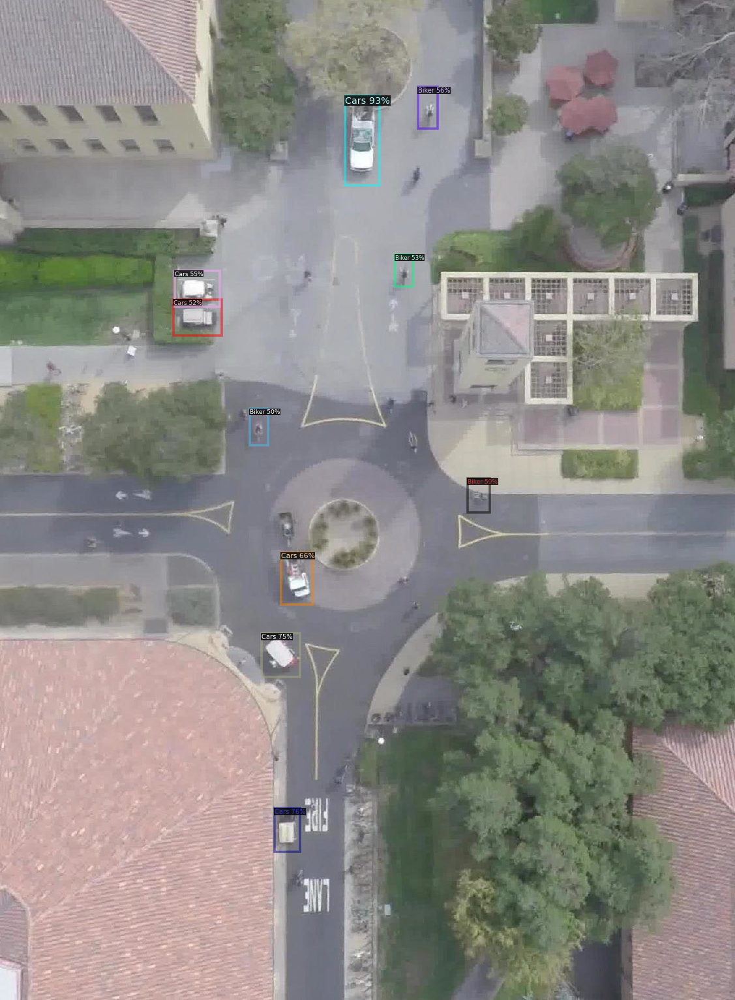

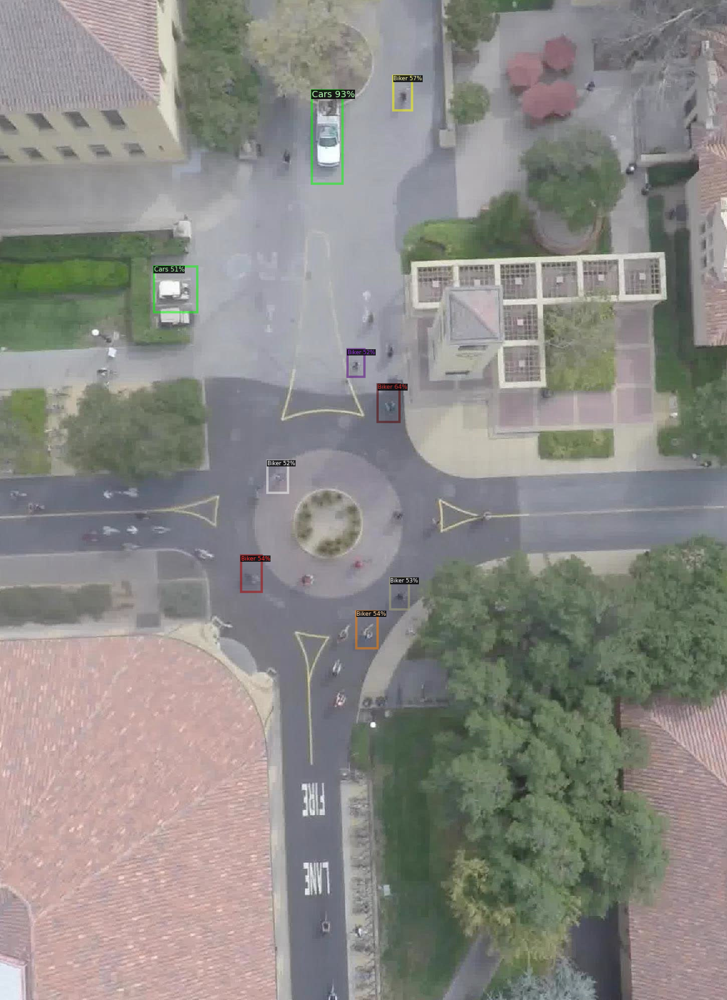

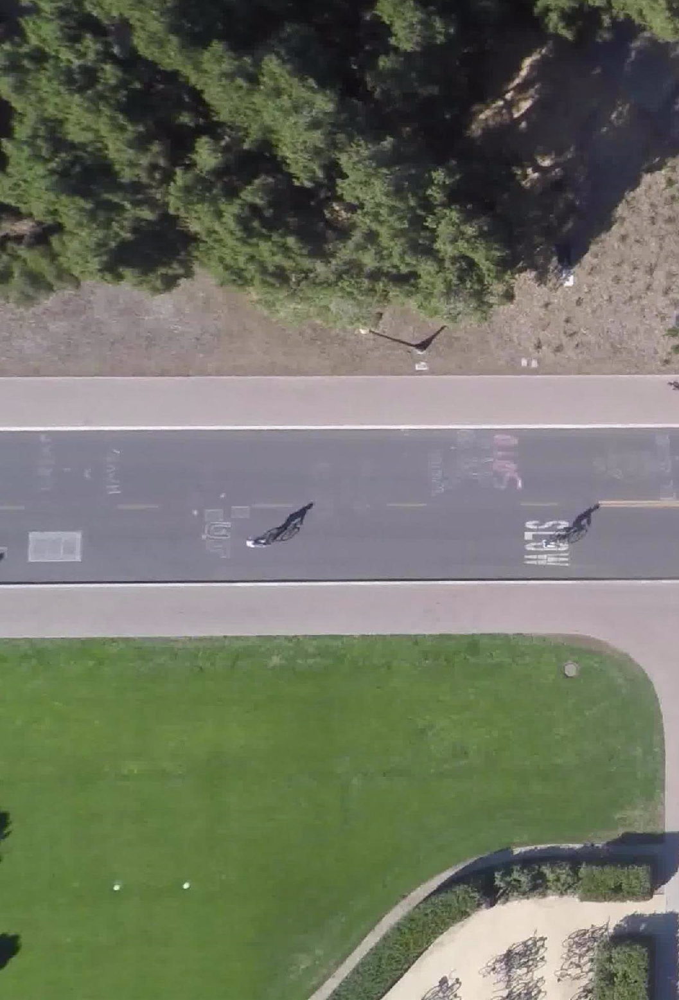

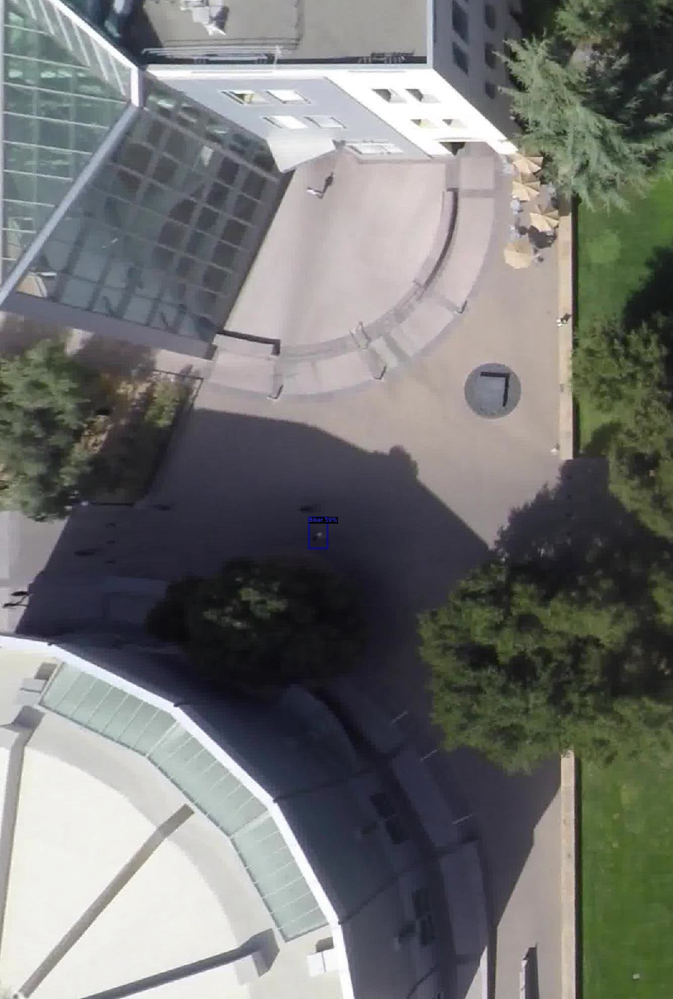

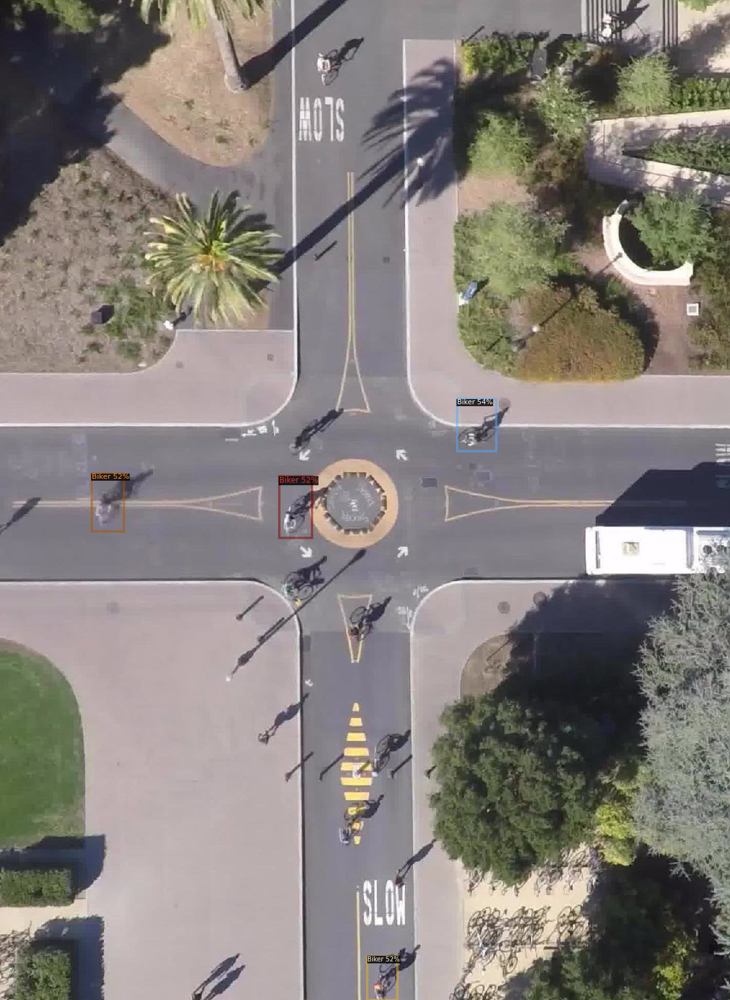

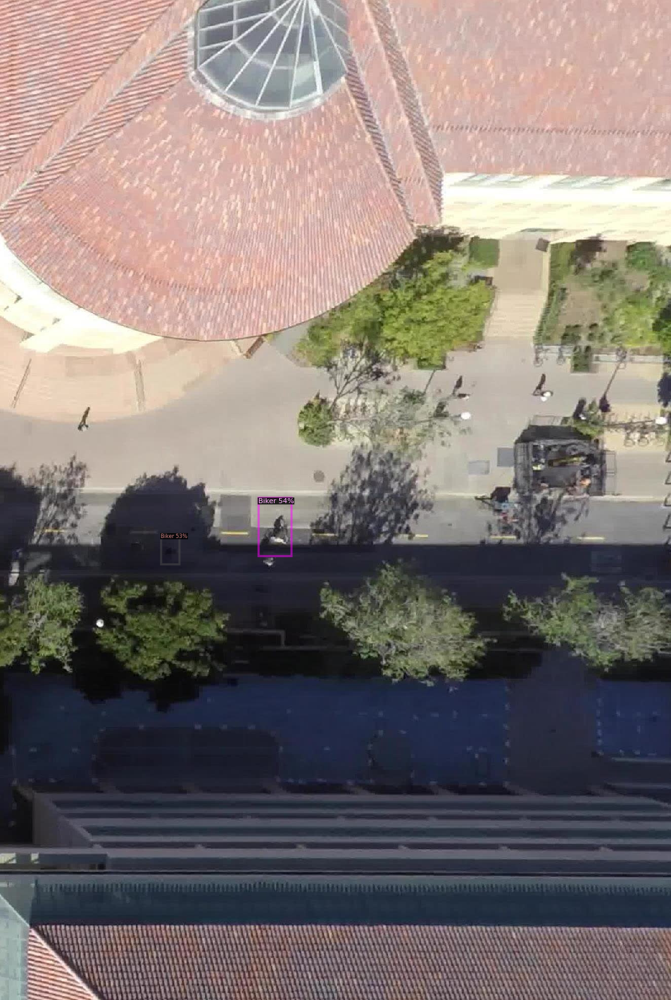

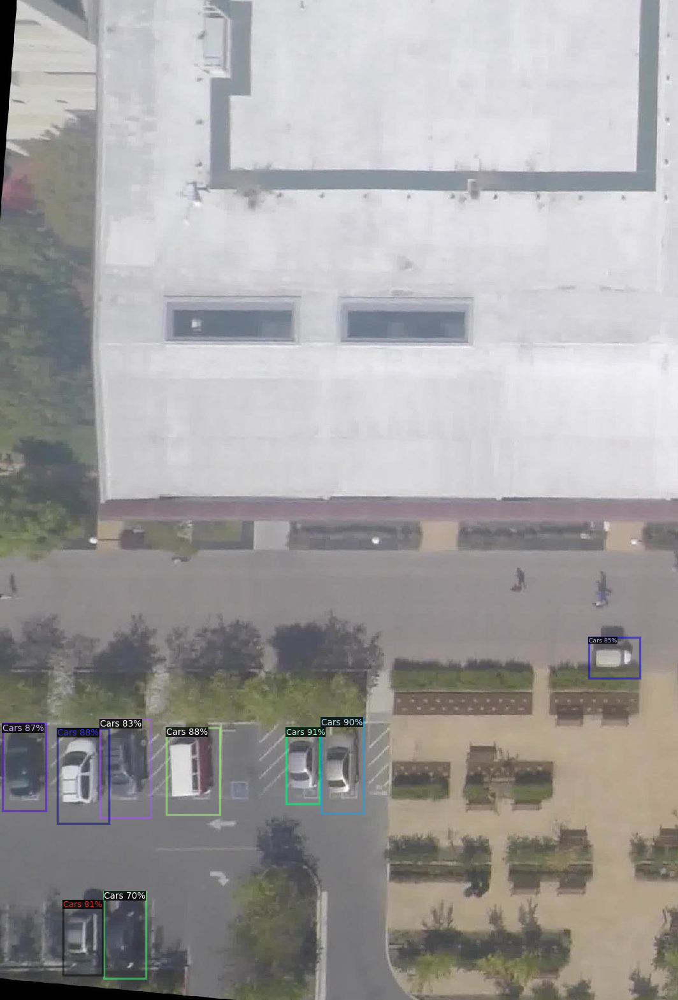

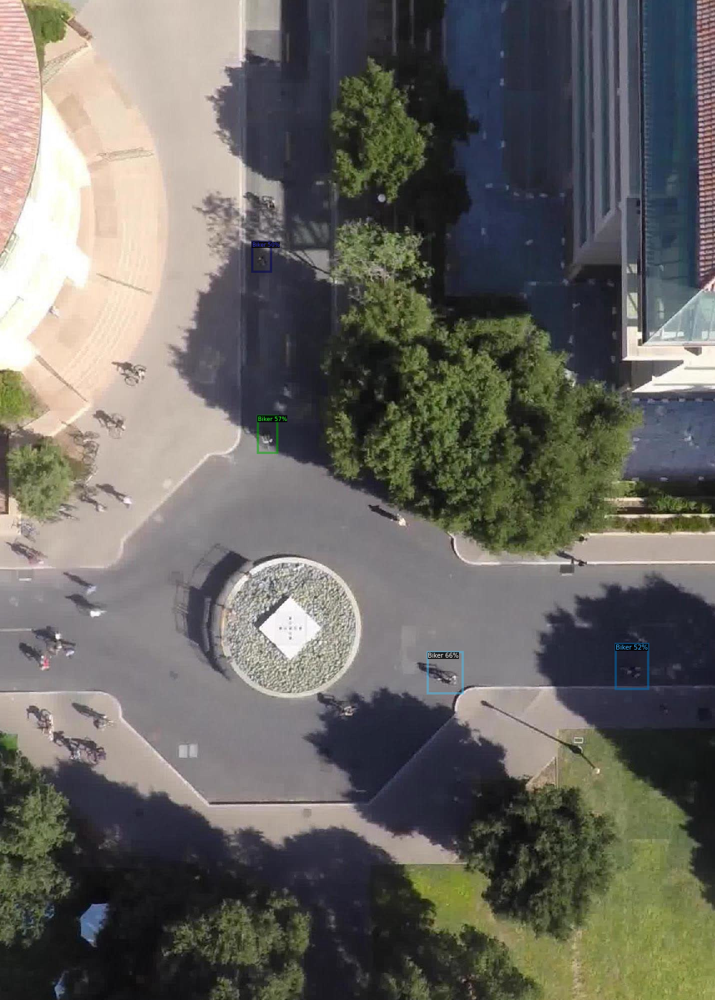

In [84]:
from detectron2.utils.visualizer import ColorMode

for d in random.sample(dataset_dicts, 10):    
    im = cv2.imread(d["file_name"])
    outputs = predictor(im)
    v = Visualizer(im[:, :, ::-1],
                   metadata=metadata, 
                   scale=0.8, 
                   instance_mode=ColorMode.IMAGE_BW   # remove the colors of unsegmented pixels
    )
    v = v.draw_instance_predictions(outputs["instances"].to("cpu"))
    cv2_imshow(v.get_image()[:, :, ::-1])

In [85]:
import detectron2
from detectron2.utils.logger import setup_logger
setup_logger()
# import some common libraries
import numpy as np
import tqdm
import cv2

In [86]:
video_path = '/content/drive/MyDrive/data-yolov5/videos/deathCircle/video2/video.mov'

In [87]:
video = cv2.VideoCapture(video_path)
width = int(video.get(cv2.CAP_PROP_FRAME_WIDTH))
height = int(video.get(cv2.CAP_PROP_FRAME_HEIGHT))
fps = video.get(cv2.CAP_PROP_FPS)
num_frames = int(video.get(cv2.CAP_PROP_FRAME_COUNT))

In [88]:
num_frames

431

In [107]:
video_writer = cv2.VideoWriter('video4.mp4', fourcc=cv2.VideoWriter_fourcc(*"mp4v"), fps=float(frames_per_second), frameSize=(width, height), isColor=True)
# predictor defined above
# predictor = DefaultPredictor(cfg)

In [108]:
def runOnVideo(video, maxFrames):
    """ Runs the predictor on every frame in the video (unless maxFrames is given),
    and returns the frame with the predictions drawn.
    """

    readFrames = 0
    while True:
        hasFrame, frame = video.read()
        if not hasFrame:
            print('No Frame Left')
            break

        # Get prediction results for this frame
        outputs = predictor(frame)
        print(outputs)
        # Make sure the frame is colored
        frame = cv2.cvtColor(frame, cv2.COLOR_RGB2BGR)

        v = Visualizer(frame[:, :, ::-1],
                   metadata=metadata, 
                   scale=1, 
                   instance_mode=ColorMode.IMAGE_BW   # remove the colors of unsegmented pixels
        )
        
        v = v.draw_instance_predictions(outputs["instances"].to("cpu"))
        cv2_imshow(v.get_image()[:, :, ::-1])
        
        yield v

        readFrames += 1
        if readFrames > maxFrames:
            break

In [110]:
num_frames = 10
for visualization in tqdm.tqdm(runOnVideo(video, num_frames), total=num_frames): 
  #pass
  video_writer.write(visualization)
    # Write to video file
    #video_writer.write(visualization)

# Release resources
video.release()
video_writer.release()
cv2.destroyAllWindows()





  0%|          | 0/10 [00:00<?, ?it/s]

No Frame Left


In [ ]:
cv2.w